In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import geopandas as gpd
%matplotlib inline

In [30]:
countries = gpd.read_file('Dataset/countries.geojson')
indo = gpd.read_file('Dataset/IDN_adm_2_kabkota.json')

In [3]:
countries.head()

,ADMIN,ISO_A3,geometry
0,Aruba,ABW,"POLYGON ((-69.99694 12.57758, -69.93639 12.531..."
1,Afghanistan,AFG,"POLYGON ((71.04980 38.40866, 71.05714 38.40903..."
2,Angola,AGO,"MULTIPOLYGON (((11.73752 -16.69258, 11.73851 -..."
3,Anguilla,AIA,"MULTIPOLYGON (((-63.03767 18.21296, -63.09952 ..."
4,Albania,ALB,"POLYGON ((19.74777 42.57890, 19.74601 42.57993..."


In [4]:
np.random.seed(30)
countries['gdppercap'] = np.random.randint(300, 110000, countries.shape[0])
countries.head()

,ADMIN,ISO_A3,geometry,gdppercap
0,Aruba,ABW,"POLYGON ((-69.99694 12.57758, -69.93639 12.531...",38993
1,Afghanistan,AFG,"POLYGON ((71.04980 38.40866, 71.05714 38.40903...",70353
2,Angola,AGO,"MULTIPOLYGON (((11.73752 -16.69258, 11.73851 -...",48345
3,Anguilla,AIA,"MULTIPOLYGON (((-63.03767 18.21296, -63.09952 ...",99104
4,Albania,ALB,"POLYGON ((19.74777 42.57890, 19.74601 42.57993...",46520


In [5]:
countries_gdpcap = countries.copy()

In [6]:
countries_gdpcap['area'] = countries_gdpcap.area
countries_gdpcap.head(10)

,ADMIN,ISO_A3,geometry,gdppercap,area
0,Aruba,ABW,"POLYGON ((-69.99694 12.57758, -69.93639 12.531...",38993,0.014119
1,Afghanistan,AFG,"POLYGON ((71.04980 38.40866, 71.05714 38.40903...",70353,62.591667
2,Angola,AGO,"MULTIPOLYGON (((11.73752 -16.69258, 11.73851 -...",48345,103.585468
3,Anguilla,AIA,"MULTIPOLYGON (((-63.03767 18.21296, -63.09952 ...",99104,0.006891
4,Albania,ALB,"POLYGON ((19.74777 42.57890, 19.74601 42.57993...",46520,3.039396
5,Aland,ALA,"MULTIPOLYGON (((20.92018 59.90925, 20.91236 59...",66755,0.152389
6,Andorra,AND,"POLYGON ((1.70701 42.50278, 1.69750 42.49446, ...",96353,0.049561
7,United Arab Emirates,ARE,"MULTIPOLYGON (((53.86305 24.23469, 53.88860 24...",103463,6.303561
8,Argentina,ARG,"MULTIPOLYGON (((-68.65412 -54.88624, -68.65414...",54717,278.681064
9,Armenia,ARM,"MULTIPOLYGON (((45.54717 40.62155, 45.51369 40...",16090,3.133778


In [7]:
countries_gdpcap = countries_gdpcap[countries_gdpcap['ADMIN'] != 'Antarctica']

In [9]:
gpd.show_versions()


SYSTEM INFO
-----------
python     : 3.7.6 | packaged by conda-forge | (default, Jun  1 2020, 18:11:50) [MSC v.1916 64 bit (AMD64)]
executable : C:\Users\naufa\miniconda3\envs\jlml\python.exe
machine    : Windows-10-10.0.18362-SP0

GEOS, GDAL, PROJ INFO
---------------------
GEOS       : None
GEOS lib   : None
GDAL       : 3.0.4
GDAL data dir: None
PROJ       : 7.0.0
PROJ data dir: C:\Users\naufa\miniconda3\envs\jlml\Library\share\proj

PYTHON DEPENDENCIES
-------------------
geopandas  : 0.7.0
pandas     : 0.25.3
fiona      : 1.8.13
numpy      : 1.18.1
shapely    : 1.7.0
rtree      : 0.9.4
pyproj     : 2.6.1.post1
matplotlib : 3.1.2
mapclassify: None
pysal      : None
geopy      : None
psycopg2   : None


In [10]:
current_crs = countries_gdpcap.crs
current_crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [28]:
countries_gdpcap_3857  = countries_gdpcap.to_crs(epsg=3857)

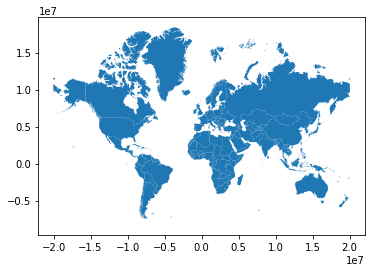

In [29]:
countries_gdpcap_3857.plot();

In [12]:
new_crs = countries_gdpcap_3857.crs
new_crs

<Projected CRS: EPSG:3857>
Name: WGS 84 / Pseudo-Mercator
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: World - 85°S to 85°N
- bounds: (-180.0, -85.06, 180.0, 85.06)
Coordinate Operation:
- name: Popular Visualisation Pseudo-Mercator
- method: Popular Visualisation Pseudo Mercator
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

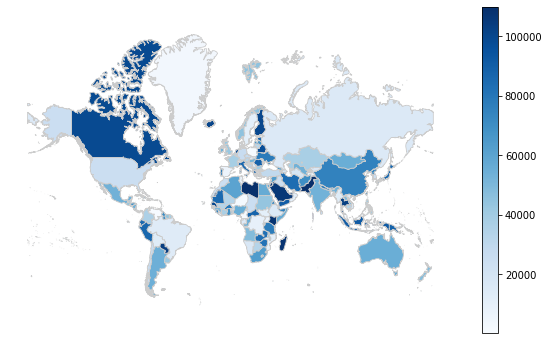

In [48]:
variable = 'gdppercap'
vmin, vmax = 300, 110000
fig, ax = plt.subplots(1, figsize=(10, 6))
countries_gdpcap_3857.plot(
    column=variable, 
    cmap='Blues', 
    linewidth=0.8, 
    ax=ax, 
    edgecolor='0.8'
    )
ax.axis('off')

# Create colorbar as a legend
sm = plt.cm.ScalarMappable(cmap='Blues', norm=plt.Normalize(vmin=vmin, vmax=vmax))
# empty array for the data range
sm._A = []
# add the colorbar to the figure
cbar = fig.colorbar(sm);